# **Estrutura Do trabalho**

Primeiramente, realizo a análise exploratória dos dados e proponho algumas hipóteses.

Em seguida, respondo à pergunta 2.a relacionada à recomendação de filmes e proponho uma escolha aleatória com base em algumas possibilidades.

Na pergunta 2.B, respondo a essa pergunta investigando correlação e causalidade, além de propor a utilização de um modelo para responder à pergunta. Inicialmente, uso um modelo simples que avalia apenas as variáveis numéricas. Esse modelo consegue responder à pergunta inicialmente. Em seguida, crio um modelo mais complexo com encoders para realizar uma análise mais completa, incluindo também as variáveis categóricas.

Também testei um modelo com SVM na pergunta 2.C. Os resultados não foram satisfatórios, mas fiz isso apenas para teste.

Na pergunta 3, respondo à pergunta e aproveito para discutir sobre os modelos existentes.

Na pergunta 4, utilizo também um modelo de árvore de decisão para realizar inferências.

Como a questão 5 requer que os modelos sejam salvos em arquivos .pkl, isso foi realizado.

O código completo está disponível no GitHub.

Também subi o projeto para o Google Colab.

O arquivo README explica o projeto.

Um arquivo com todos os requisitos e pacotes utilizados também está disponível.


 1)  Faça uma análise exploratória dos dados (EDA), demonstrando as principais características entre as variáveis e apresentando algumas hipóteses relacionadas. Seja criativo

In [116]:
import yaml
import pandas as pd
import numpy as np
import requests
import os
from sklearn.svm import SVC
import scipy
import sidetable as stb
import missingno as msno
from scipy.stats import pearsonr
from sklearn.svm import SVR
# Data viz
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split as tests
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import (
    RandomForestRegressor,
    GradientBoostingRegressor,
    AdaBoostRegressor,
    BaggingRegressor,
    VotingRegressor
)
from sklearn import metrics

from sklearn.preprocessing import (
    MinMaxScaler, 
    StandardScaler,
    RobustScaler,
    PowerTransformer
)
import warnings

pd.set_option("display.max_rows", 1000)
sns.set_style("whitegrid")
warnings.filterwarnings("ignore")

from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import plot_tree

# Utilizando o SHAP 
import shap
from sklearn.metrics import (
    r2_score, 
    mean_absolute_error, 
    mean_squared_error, 
    confusion_matrix, 
    classification_report, 
    ConfusionMatrixDisplay
)
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, mean_absolute_percentage_error
import shap
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree
import joblib


import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.svm import LinearSVC
from sklearn.metrics import classification_report


In [117]:
#load_dotenv(find_dotenv())
path=os.getenv("path")
path = "C:/Users/Marce/Desktop/Lighhouse/desafio_indicium_imdb.csv"
df = pd.read_csv(path)
df.head()

,Unnamed: 0,Series_Title,Released_Year,Certificate,Runtime,Genre,IMDB_Rating,Overview,Meta_score,Director,Star1,Star2,Star3,Star4,No_of_Votes,Gross
0,1,The Godfather,1972,A,175 min,"Crime, Drama",9.2,An organized crime dynasty's aging patriarch t...,100.0,Francis Ford Coppola,Marlon Brando,Al Pacino,James Caan,Diane Keaton,1620367,"134,966,411"
1,2,The Dark Knight,2008,UA,152 min,"Action, Crime, Drama",9.0,When the menace known as the Joker wreaks havo...,84.0,Christopher Nolan,Christian Bale,Heath Ledger,Aaron Eckhart,Michael Caine,2303232,"534,858,444"
2,3,The Godfather: Part II,1974,A,202 min,"Crime, Drama",9.0,The early life and career of Vito Corleone in ...,90.0,Francis Ford Coppola,Al Pacino,Robert De Niro,Robert Duvall,Diane Keaton,1129952,"57,300,000"
3,4,12 Angry Men,1957,U,96 min,"Crime, Drama",9.0,A jury holdout attempts to prevent a miscarria...,96.0,Sidney Lumet,Henry Fonda,Lee J. Cobb,Martin Balsam,John Fiedler,689845,"4,360,000"
4,5,The Lord of the Rings: The Return of the King,2003,U,201 min,"Action, Adventure, Drama",8.9,Gandalf and Aragorn lead the World of Men agai...,94.0,Peter Jackson,Elijah Wood,Viggo Mortensen,Ian McKellen,Orlando Bloom,1642758,"377,845,905"


In [118]:
df = df.loc[:, ~df.columns.str.contains('^Unnamed')]
df.head()


,Series_Title,Released_Year,Certificate,Runtime,Genre,IMDB_Rating,Overview,Meta_score,Director,Star1,Star2,Star3,Star4,No_of_Votes,Gross
0,The Godfather,1972,A,175 min,"Crime, Drama",9.2,An organized crime dynasty's aging patriarch t...,100.0,Francis Ford Coppola,Marlon Brando,Al Pacino,James Caan,Diane Keaton,1620367,"134,966,411"
1,The Dark Knight,2008,UA,152 min,"Action, Crime, Drama",9.0,When the menace known as the Joker wreaks havo...,84.0,Christopher Nolan,Christian Bale,Heath Ledger,Aaron Eckhart,Michael Caine,2303232,"534,858,444"
2,The Godfather: Part II,1974,A,202 min,"Crime, Drama",9.0,The early life and career of Vito Corleone in ...,90.0,Francis Ford Coppola,Al Pacino,Robert De Niro,Robert Duvall,Diane Keaton,1129952,"57,300,000"
3,12 Angry Men,1957,U,96 min,"Crime, Drama",9.0,A jury holdout attempts to prevent a miscarria...,96.0,Sidney Lumet,Henry Fonda,Lee J. Cobb,Martin Balsam,John Fiedler,689845,"4,360,000"
4,The Lord of the Rings: The Return of the King,2003,U,201 min,"Action, Adventure, Drama",8.9,Gandalf and Aragorn lead the World of Men agai...,94.0,Peter Jackson,Elijah Wood,Viggo Mortensen,Ian McKellen,Orlando Bloom,1642758,"377,845,905"


In [119]:
df.T

,0,1,2,3,4,5,6,7,8,9,...,989,990,991,992,993,994,995,996,997,998
Series_Title,The Godfather,The Dark Knight,The Godfather: Part II,12 Angry Men,The Lord of the Rings: The Return of the King,Pulp Fiction,Schindler's List,Inception,Fight Club,The Lord of the Rings: The Fellowship of the Ring,...,Giù la testa,Kelly's Heroes,The Jungle Book,Blowup,A Hard Day's Night,Breakfast at Tiffany's,Giant,From Here to Eternity,Lifeboat,The 39 Steps
Released_Year,1972,2008,1974,1957,2003,1994,1993,2010,1999,2001,...,1971,1970,1967,1966,1964,1961,1956,1953,1944,1935
Certificate,A,UA,A,U,U,A,A,UA,A,U,...,PG,GP,U,A,U,A,G,Passed,NaN,NaN
Runtime,175 min,152 min,202 min,96 min,201 min,154 min,195 min,148 min,139 min,178 min,...,157 min,144 min,78 min,111 min,87 min,115 min,201 min,118 min,97 min,86 min
Genre,"Crime, Drama","Action, Crime, Drama","Crime, Drama","Crime, Drama","Action, Adventure, Drama","Crime, Drama","Biography, Drama, History","Action, Adventure, Sci-Fi",Drama,"Action, Adventure, Drama",...,"Drama, War, Western","Adventure, Comedy, War","Animation, Adventure, Family","Drama, Mystery, Thriller","Comedy, Music, Musical","Comedy, Drama, Romance","Drama, Western","Drama, Romance, War","Drama, War","Crime, Mystery, Thriller"
IMDB_Rating,9.2,9.0,9.0,9.0,8.9,8.9,8.9,8.8,8.8,8.8,...,7.6,7.6,7.6,7.6,7.6,7.6,7.6,7.6,7.6,7.6
Overview,An organized crime dynasty's aging patriarch t...,When the menace known as the Joker wreaks havo...,The early life and career of Vito Corleone in ...,A jury holdout attempts to prevent a miscarria...,Gandalf and Aragorn lead the World of Men agai...,"The lives of two mob hitmen, a boxer, a gangst...","In German-occupied Poland during World War II,...",A thief who steals corporate secrets through t...,An insomniac office worker and a devil-may-car...,A meek Hobbit from the Shire and eight compani...,...,A low-life bandit and an I.R.A. explosives exp...,A group of U.S. soldiers sneaks across enemy l...,Bagheera the Panther and Baloo the Bear have a...,A fashion photographer unknowingly captures a ...,"Over two ""typical"" days in the life of The Bea...",A young New York socialite becomes interested ...,Sprawling epic covering the life of a Texas ca...,"In Hawaii in 1941, a private is cruelly punish...",Several survivors of a torpedoed merchant ship...,A man in London tries to help a counter-espion...
Meta_score,100.0,84.0,90.0,96.0,94.0,94.0,94.0,74.0,66.0,92.0,...,77.0,50.0,65.0,82.0,96.0,76.0,84.0,85.0,78.0,93.0
Director,Francis Ford Coppola,Christopher Nolan,Francis Ford Coppola,Sidney Lumet,Peter Jackson,Quentin Tarantino,Steven Spielberg,Christopher Nolan,David Fincher,Peter Jackson,...,Sergio Leone,Brian G. Hutton,Wolfgang Reitherman,Michelangelo Antonioni,Richard Lester,Blake Edwards,George Stevens,Fred Zinnemann,Alfred Hitchcock,Alfred Hitchcock
Star1,Marlon Brando,Christian Bale,Al Pacino,Henry Fonda,Elijah Wood,John Travolta,Liam Neeson,Leonardo DiCaprio,Brad Pitt,Elijah Wood,...,Rod Steiger,Clint Eastwood,Phil Harris,David Hemmings,John Lennon,Audrey Hepburn,Elizabeth Taylor,Burt Lancaster,Tallulah Bankhead,Robert Donat


In [120]:
# Percentage of missing data
df.stb.missing()

,missing,total,percent
Gross,169,999,16.916917
Meta_score,157,999,15.715716
Certificate,101,999,10.110110
Series_Title,0,999,0.000000
Released_Year,0,999,0.000000
Runtime,0,999,0.000000
Genre,0,999,0.000000
IMDB_Rating,0,999,0.000000
Overview,0,999,0.000000
Director,0,999,0.000000


<Axes: >

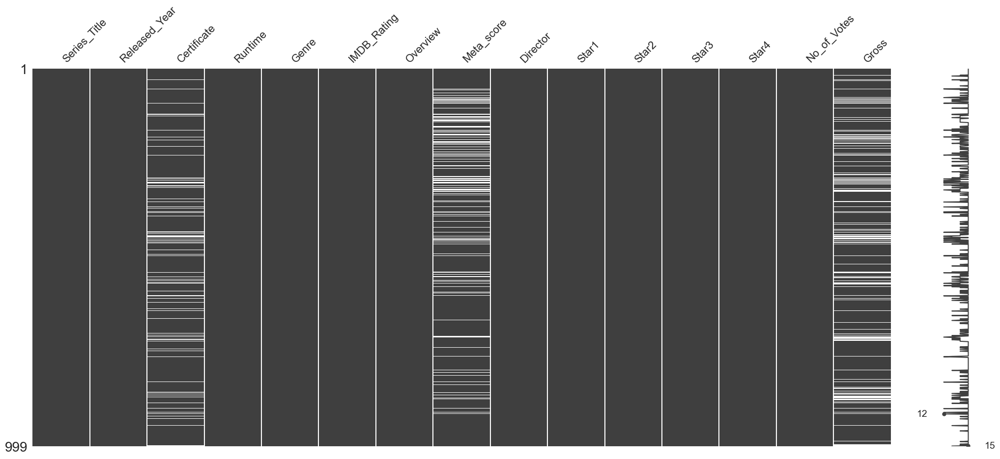

In [121]:
msno.matrix(df)

<Axes: >

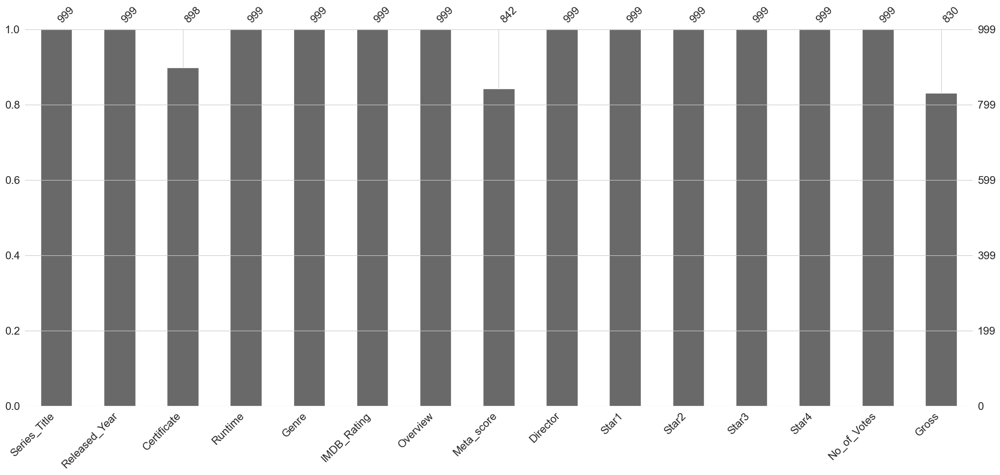

In [122]:

msno.bar(df)

Primeiramente, remover as linhas que estão vazias, e a explicação pra isso é simples.
A falta de faturamento de algumas linhas interferiria na minha tentativa de visualizar correlações para isso.

então remover, depois fazer correlação.

In [123]:
df = df.dropna(subset=['Certificate', 'Meta_score', 'Gross'])


É costume separar variaveis categoricas e numericas:


In [124]:

df['Gross'] = df['Gross'].str.replace(',', '').astype(float)
df['Released_Year'] = pd.to_numeric(df['Released_Year'], errors='coerce').astype('Int64')
df['Runtime'] = df['Runtime'].str.replace(' min', '').astype('Int64')
cat_col=df.select_dtypes(exclude="number").columns.to_list()
num_col=[col for col in df if col not in cat_col]

In [125]:
num_col

['Released_Year',
 'Runtime',
 'IMDB_Rating',
 'Meta_score',
 'No_of_Votes',
 'Gross']

In [126]:
cat_col

['Series_Title',
 'Certificate',
 'Genre',
 'Overview',
 'Director',
 'Star1',
 'Star2',
 'Star3',
 'Star4']

In [127]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 713 entries, 0 to 996
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Series_Title   713 non-null    object 
 1   Released_Year  712 non-null    Int64  
 2   Certificate    713 non-null    object 
 3   Runtime        713 non-null    Int64  
 4   Genre          713 non-null    object 
 5   IMDB_Rating    713 non-null    float64
 6   Overview       713 non-null    object 
 7   Meta_score     713 non-null    float64
 8   Director       713 non-null    object 
 9   Star1          713 non-null    object 
 10  Star2          713 non-null    object 
 11  Star3          713 non-null    object 
 12  Star4          713 non-null    object 
 13  No_of_Votes    713 non-null    int64  
 14  Gross          713 non-null    float64
dtypes: Int64(2), float64(3), int64(1), object(9)
memory usage: 90.5+ KB


In [128]:
df.describe()

,Released_Year,Runtime,IMDB_Rating,Meta_score,No_of_Votes,Gross
count,712.0,713.0,713.000000,713.000000,7.130000e+02,7.130000e+02
mean,1995.738764,123.690042,7.935203,77.154278,3.533480e+05,7.858395e+07
std,18.611182,25.896632,0.288999,12.409392,3.462212e+05,1.150433e+08
min,1930.0,72.0,7.600000,28.000000,2.522900e+04,1.305000e+03
25%,1986.75,104.0,7.700000,70.000000,9.582600e+04,6.153939e+06
50%,2001.0,120.0,7.900000,78.000000,2.363110e+05,3.500000e+07
75%,2010.0,136.0,8.100000,86.000000,5.059180e+05,1.025158e+08
max,2019.0,238.0,9.200000,100.000000,2.303232e+06,9.366622e+08


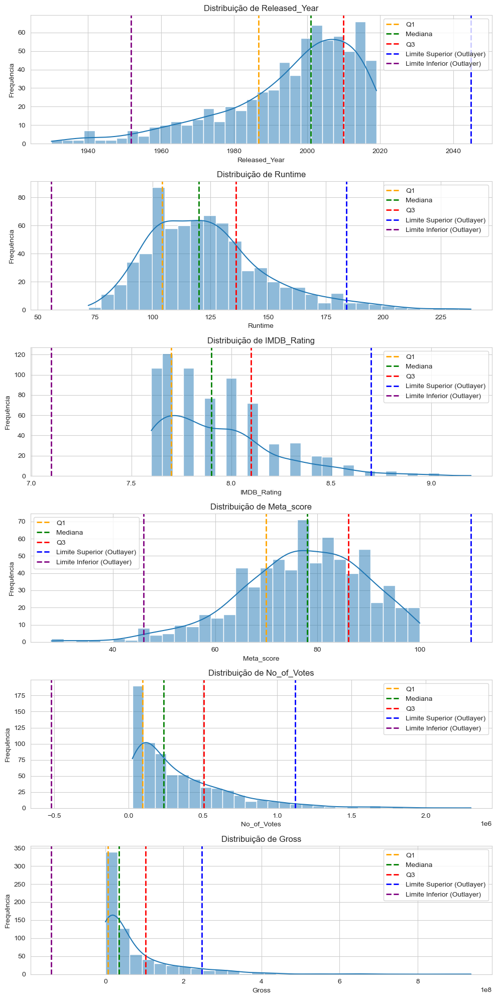

In [129]:
#EU poderia só fazer um # Distribuição das variáveis numéricas df.hist(bins=20, figsize=(14, 10)) // plt.show(), mas assim eu perderia os quantils.

# Definir as variáveis numéricas de interesse
numeric_cols = ['Released_Year', 'Runtime', 'IMDB_Rating', 'Meta_score', 'No_of_Votes', 'Gross']

# Configurar a figura e os eixos dos subplots
fig, axes = plt.subplots(nrows=len(numeric_cols), figsize=(10, 20))

# Iterar sobre as variáveis numéricas e plotar histogramas
for i, col in enumerate(numeric_cols):
    sns.histplot(df[col], bins=30, kde=True, ax=axes[i])  # 'bins' define o número de intervalos no histograma
    
    # Adicionar linhas verticais para os quartis
    axes[i].axvline(df[col].quantile(0.25), color='orange', linestyle='dashed', linewidth=2, label='Q1')
    axes[i].axvline(df[col].quantile(0.5), color='green', linestyle='dashed', linewidth=2, label='Mediana')
    axes[i].axvline(df[col].quantile(0.75), color='red', linestyle='dashed', linewidth=2, label='Q3')
    
    # Calcular o intervalo interquartil (IQR)
    IQR = df[col].quantile(0.75) - df[col].quantile(0.25)
    upper_limit = df[col].quantile(0.75) + 1.5 * IQR
    lower_limit = df[col].quantile(0.25) - 1.5 * IQR
    
    # Adicionar linhas verticais para os limites do IQR
    axes[i].axvline(upper_limit, color='blue', linestyle='dashed', linewidth=2, label='Limite Superior (Outlayer)')
    axes[i].axvline(lower_limit, color='purple', linestyle='dashed', linewidth=2, label='Limite Inferior (Outlayer)')
    
    axes[i].set_title(f'Distribuição de {col}')
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Frequência')
    axes[i].legend()

plt.tight_layout()
plt.show()


#Quero ver as correlações entre as variaveis numericas, No momento não faz sentido utilizar algum encoder para ver se as variaveis categoricas possuem correlação.
Isso é só uma analise superficial.
Eu prefiro visualizar a matriz de correlação da primeira forma, mas eu coloco a segunda só por questão de agradar a todos.

OBS: CORRELAÇÃO NÃO IMPLICA EM CAUSALIDADE

In [130]:
num_col2=df.select_dtypes(include=['int64', 'float64']).columns.tolist()
corr=df[num_col2].corr()



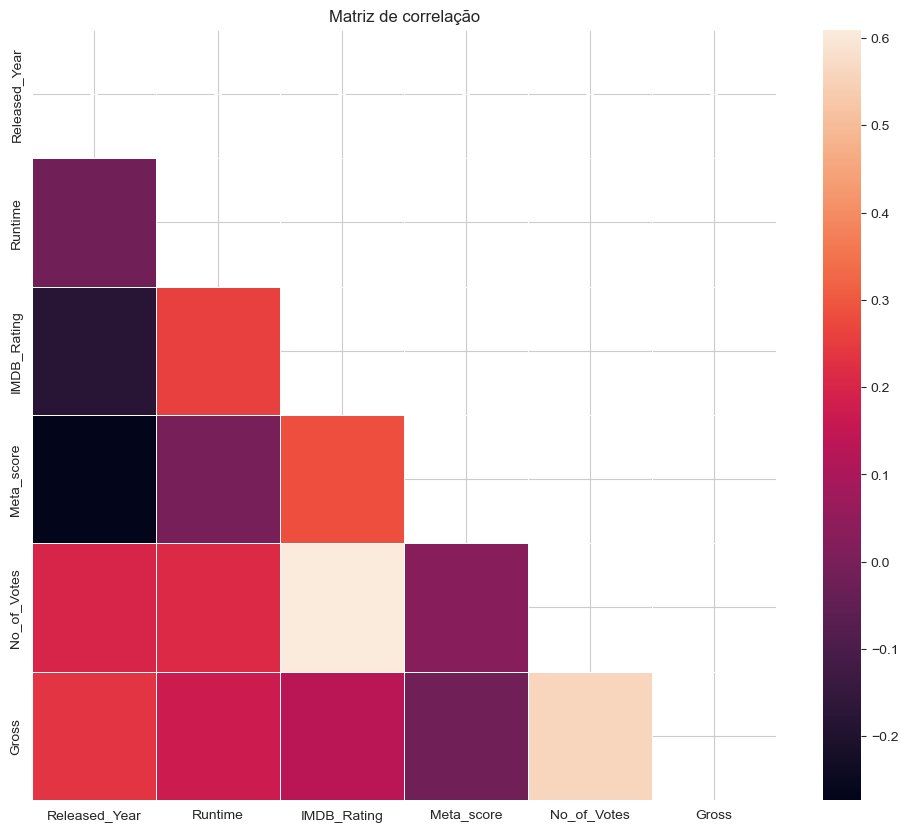

In [131]:
mask=np.triu(np.ones_like(corr))
plt.figure(figsize=(12,10))
sns.heatmap(corr, mask=mask, annot=True, linewidths=0.5)
plt.yticks(rotation=90)
plt.title('Matriz de correlação')
plt.show()

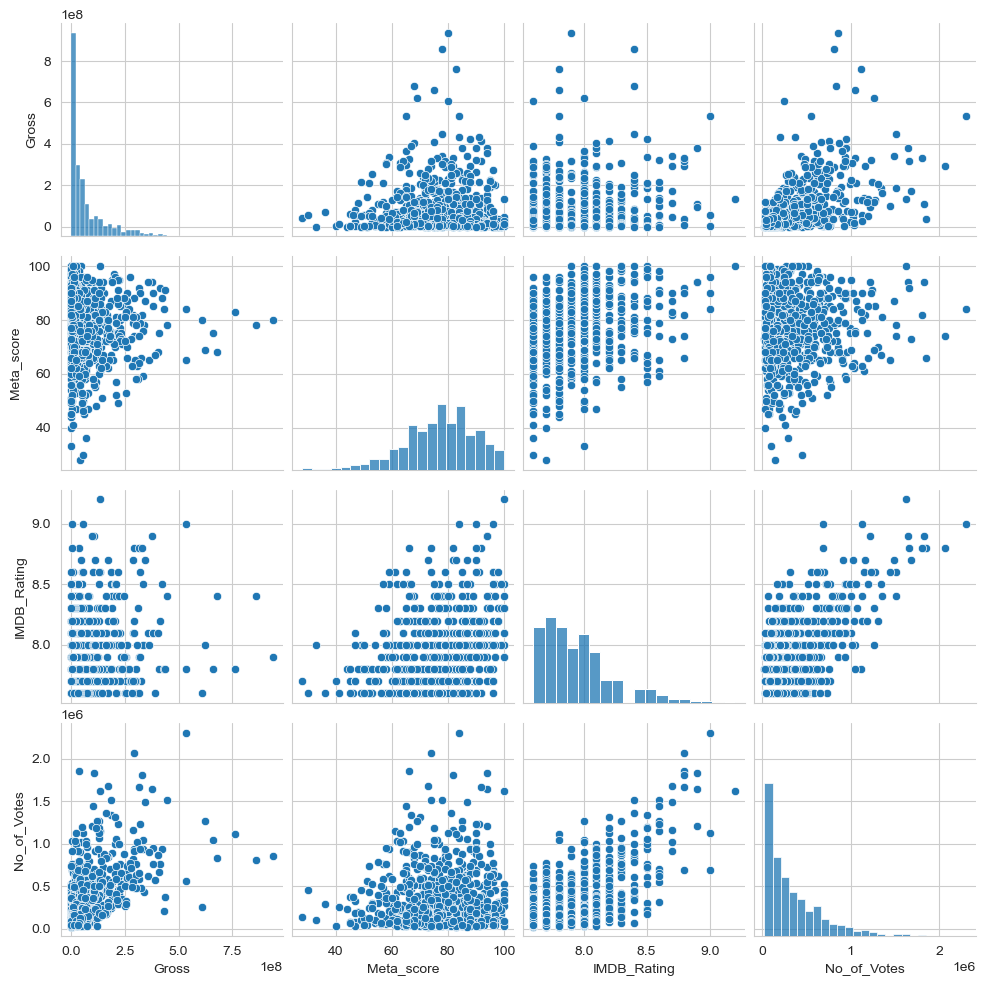

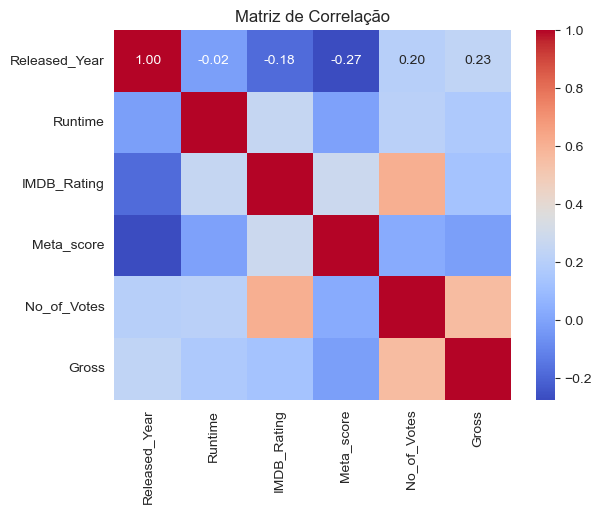

In [132]:
df_numeric = df.select_dtypes(include=['int64', 'float64'])

sns.pairplot(df_numeric[['Gross', 'Meta_score', 'IMDB_Rating', 'No_of_Votes']])
plt.show()

# Correlações
correlation_matrix = df_numeric.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Matriz de Correlação')
plt.show()

In [133]:
# Calcular a correlação entre Meta_score e Gross
correlation = df['Meta_score'].corr(df['Gross'])
print(f"Correlação entre Meta_score e Gross: {correlation}")

#já foi possível visualizar o grafico entre essas duas variaveis.



# Calcular o coeficiente de correlação de Pearson e o p-valor
pearson_corr, p_value = pearsonr(df['Meta_score'], df['Gross'])
print(f"Coeficiente de correlação de Pearson: {pearson_corr}")
print(f"P-valor: {p_value}")


Correlação entre Meta_score e Gross: -0.014663267036396728
Coeficiente de correlação de Pearson: -0.014663267036396728
P-valor: 0.6958907691244433


In [134]:
# Podemos melhorar isso
df.corr(method= 'pearson', numeric_only=True)

,Released_Year,Runtime,IMDB_Rating,Meta_score,No_of_Votes,Gross
Released_Year,1.000000,-0.017884,-0.178896,-0.272659,0.200074,0.234654
Runtime,-0.017884,1.000000,0.257640,-0.005948,0.212927,0.169380
IMDB_Rating,-0.178896,0.257640,1.000000,0.283745,0.609239,0.130857
Meta_score,-0.272659,-0.005948,0.283745,1.000000,0.028578,-0.014663
No_of_Votes,0.200074,0.212927,0.609239,0.028578,1.000000,0.560955
Gross,0.234654,0.169380,0.130857,-0.014663,0.560955,1.000000


In [135]:
df.corr(method= 'spearman', numeric_only=True)

,Released_Year,Runtime,IMDB_Rating,Meta_score,No_of_Votes,Gross
Released_Year,1.000000,0.049229,-0.151144,-0.172746,0.233268,0.180343
Runtime,0.049229,1.000000,0.211351,-0.059382,0.176382,0.215669
IMDB_Rating,-0.151144,0.211351,1.000000,0.289360,0.398701,0.028558
Meta_score,-0.172746,-0.059382,0.289360,1.000000,-0.012259,-0.067911
No_of_Votes,0.233268,0.176382,0.398701,-0.012259,1.000000,0.657247
Gross,0.180343,0.215669,0.028558,-0.067911,0.657247,1.000000


**Correlação de Pearson**

A [__Correlação de Pearson__](https://pt.wikipedia.org/wiki/Coeficiente_de_correla%C3%A7%C3%A3o_de_Pearson) é expressa como  a **taxa de relação LINEAR entre duas variáveis numéricas**. Quanto mais próximo de 1 ou -1, mais **linearmente correlacionado estão as variáveis testadas**. A fórmula define-se como:


População:
$\rho = \displaystyle{\frac{\sigma_{XY}}{\sigma_X \sigma_Y }}$

Amostra:
$r = \displaystyle{\frac{s_{XY}}{{s_X s_Y }}}$


Propriedade: 

 $-1 \leq \rho \leq 1$
 
 $-1 \leq r \leq 1$


É comum usar as seguintes classificações ($\rho$ para populações):

1. $r=1$ indica uma correlação perfeita e positiva

2. $r=-1$ indica uma correlação perfeita e negativa

3. $0.7 \leq |r| \leq 1$ indica uma correlação forte

4. $0.5 \leq |r| \leq 0.69$ indica uma correlação moderada

5. $0 \leq |r| \leq 0.49$ indica uma correlação fraca
<br>

**Correlação de Spearman**

[__Correlação de Spearmann__](https://pt.wikipedia.org/wiki/Coeficiente_de_correla%C3%A7%C3%A3o_de_postos_de_Spearman) e outra correlação linear bem conhecida e este coeficiente indica se as amostras possuem correlação *monotônica*, isso é, **se aumentarmos ou diminuimos uma, a outra irá aumentar ou diminuir**. 

Fórmula: $ r = 1 - \frac{6\sum_{i=1}^{n}d_i^2}{n(n^2-1)} $

O coeficiente varia entre -1 e 1:

> Quanto mais próximo de 1 for o coeficiente, mais positivamente correlacionada as amostras, isso é, se aumentarmos uma, a outra ira aumentar (ou se diminuimos uma, a outra irá diminuir); 

> Quanto mais próximo de -1 for o resultado, mais negativamente correlacionada estão as variáveis, isso é, aumentando uma, a outra irá dimunuir (ou se diminuímos uma, a outra irá aumentar). 

> Uma correlação de 0 indica ausência de correlação.

**Importante:** o coeficiente de Spearman **não** indica correlação necessariamente linear!

## ANALISE EXPLORATÓRIA DE DADOS !!

- Eu não gosto de usar a segunda forma de matriz de correlação pois ela vem naturalmente duplicada.


Foi possível observar 2 correlaçãoes bem significativas. 

A primeira sendo entre o faturamento e o numero de votos.

A segunda sendo entre o IMDB_Rating e o Numero de votos .


Falando em relação ao meu pairplot:


O grafico Meta_socre X IMDB_Raring gerou um formato diferente, mas mesmo assim, sem uma correlação significativa !!

Meu grafico de META_SOCRE X GROSS, assim como o number_votes x meta_score mais parecem gerar grande um cluster, mas isso é assunto pra k-means e outros algoritmos do tipo

Gross x number of votes gerou claramente uma correlação visivel, k-means, knn e svm são os algoritmos que logo vem a mente.

IMDB_Rating X Numero de votos gera uma correlação, mas não tão agradavel aos olhos e isso é explicado pela correlação de spearman, por isso também a utilizei.




## FIM DA ANALISE EXPLORATÓRIA 

-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

# HIPOTESES

O tema das hipóteses pode frequentemente envolver conceitos estatísticos. Por exemplo, em casos de classificação, pode-se usar a ideia de Bernoulli para decisões binárias, como sim ou não, e testes de Shapiro-Wilk para verificar a normalidade da amostra. Entretanto, acredito que este não seja o foco deste projeto.



Hipoteses obvias: 

Maior Engajamento do Público Gera Maior Receita Bruta: Correlação entre Gross e No_of_votes.

O IMDb Influencia o Público?: Filmes com melhores avaliações atraem mais espectadores, levando a mais votos. Relaciona IMDB_RATING e No_of_votes.


##  Hipoteses criativas:
Popularidade Significa Sucesso Financeiro?: Número de votos pode prever o faturamento usando regressão ou métodos similares. Relaciona No_of_votes e Gross.

Aclamação da Crítica Não Significa Sucesso Financeiro!: Relaciona Meta_score e Gross. A falta de correlação forte entre Meta_score e Gross no pairplot indica que a aclamação da crítica pode não influenciar diretamente o desempenho financeiro de um filme. 

Isso pode ser testado usando análise de correlação.




## Hipoteses sem futuro:
Podemos agrupar o meta_score e o engajamento do publico (no_of_votes) usando o k-means para identificar grupos, entretanto é mais facil pensar o segundo grupo como um outlayer do que como uma regra. Essa hipotese não me parece ter futuro.

Analises envolvento o Runtime

Analises envolvendo o ano de lançamento.

Sem futuro pois são analises que estão sujeitas a muitas outras variaveis, algo que vai aumentar o grau de complexidade. É um processo seletivo e eu vou escolher algo que seja agradavel



# 2)
# A) Qual filme você recomendaria para uma pessoa que você não conhece ?

Eu posso realizar uma série de interseções e, dentre elas, selecionar aleatoriamente algum filme. Algumas informações, como se a pessoa conhece o filme, podem ser perguntadas após a minha escolha. 

Eu também poderia perguntar qual o gênero favorito primeiramente, mas para isso eu precisaria conhecer a pessoa.

Sendo assim, fiz uma escolha baseada em outliers estatísticos. Com base na lista, procurei selecionar os filmes que se destacaram não apenas em uma, mas em quatro categorias que são matematicamente possíveis de avaliar.



In [136]:
# Filtrar os filmes com base nos critérios fornecidos

filtered_df = df[
    (df['IMDB_Rating'] > 8.0) &
    (df['Meta_score'] > 85) &
    (df['No_of_Votes'] >= 505917) &
    (df['Gross'] >= 102515700)
]
filtered_df

,Series_Title,Released_Year,Certificate,Runtime,Genre,IMDB_Rating,Overview,Meta_score,Director,Star1,Star2,Star3,Star4,No_of_Votes,Gross
0,The Godfather,1972,A,175,"Crime, Drama",9.2,An organized crime dynasty's aging patriarch t...,100.0,Francis Ford Coppola,Marlon Brando,Al Pacino,James Caan,Diane Keaton,1620367,134966411.0
4,The Lord of the Rings: The Return of the King,2003,U,201,"Action, Adventure, Drama",8.9,Gandalf and Aragorn lead the World of Men agai...,94.0,Peter Jackson,Elijah Wood,Viggo Mortensen,Ian McKellen,Orlando Bloom,1642758,377845905.0
5,Pulp Fiction,1994,A,154,"Crime, Drama",8.9,"The lives of two mob hitmen, a boxer, a gangst...",94.0,Quentin Tarantino,John Travolta,Uma Thurman,Samuel L. Jackson,Bruce Willis,1826188,107928762.0
9,The Lord of the Rings: The Fellowship of the Ring,2001,U,178,"Action, Adventure, Drama",8.8,A meek Hobbit from the Shire and eight compani...,92.0,Peter Jackson,Elijah Wood,Ian McKellen,Orlando Bloom,Sean Bean,1661481,315544750.0
12,The Lord of the Rings: The Two Towers,2002,UA,179,"Action, Adventure, Drama",8.7,While Frodo and Sam edge closer to Mordor with...,87.0,Peter Jackson,Elijah Wood,Ian McKellen,Viggo Mortensen,Orlando Bloom,1485555,342551365.0
23,Saving Private Ryan,1998,R,169,"Drama, War",8.6,"Following the Normandy Landings, a group of U....",91.0,Steven Spielberg,Tom Hanks,Matt Damon,Tom Sizemore,Edward Burns,1235804,216540909.0
28,Star Wars,1977,UA,121,"Action, Adventure, Fantasy",8.6,Luke Skywalker joins forces with a Jedi Knight...,90.0,George Lucas,Mark Hamill,Harrison Ford,Carrie Fisher,Alec Guinness,1231473,322740140.0
42,The Lion King,1994,U,88,"Animation, Adventure, Drama",8.5,Lion prince Simba and his father are targeted ...,88.0,Roger Allers,Rob Minkoff,Matthew Broderick,Jeremy Irons,James Earl Jones,942045,422783777.0
46,Back to the Future,1985,U,116,"Adventure, Comedy, Sci-Fi",8.5,"Marty McFly, a 17-year-old high school student...",87.0,Robert Zemeckis,Michael J. Fox,Christopher Lloyd,Lea Thompson,Crispin Glover,1058081,210609762.0
65,WALL·E,2008,U,98,"Animation, Adventure, Family",8.4,"In the distant future, a small waste-collectin...",95.0,Andrew Stanton,Ben Burtt,Elissa Knight,Jeff Garlin,Fred Willard,999790,223808164.0


In [137]:
random_movie = filtered_df.sample(n=1)
print(random_movie['Series_Title'].values[0])

The Godfather


## B) Quais são os principais fatores que estão relacionados com alta expectativa de faturamento de um filme ?

Eu poderia responder isso utilizando a correlação do faturamento com as outras variaveis, entretanto isso não estaria certo, pois correlação não implica em causalidade.

Para poder responder isso eu necessariamente preciso criar um modelo que me mostre de fato como cada variavel influencia, sendo uma arvore de decisão a melhor escolha para isso !!

In [138]:

# Carregar o dataset
path = "C:/Users/Marce/Desktop/Lighhouse/desafio_indicium_imdb.csv"
df = pd.read_csv(path)

# Remover colunas desnecessárias
df = df.loc[:, ~df.columns.str.contains('^Unnamed')]

# Limpar os dados
df = df.dropna(subset=['Certificate', 'Meta_score', 'Gross'])
df['Gross'] = df['Gross'].str.replace(',', '').astype(float)
df['Released_Year'] = pd.to_numeric(df['Released_Year'], errors='coerce').astype('Int64')
df['Runtime'] = df['Runtime'].str.replace(' min', '').astype('Int64')

# Selecionar as variáveis de interesse
features = ['Released_Year', 'Runtime', 'IMDB_Rating', 'Meta_score', 'No_of_Votes']
X = df[features]
y = df['Gross']

# Dividir os dados em conjuntos de treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)



In [139]:
# Criar o preprocessor para variáveis numéricas
numeric_features = ['Released_Year', 'Runtime', 'IMDB_Rating', 'Meta_score', 'No_of_Votes']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', StandardScaler())
])

# Criar o ColumnTransformer apenas com o preprocessor para variáveis numéricas
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features)
    ])

# Criar o pipeline com o modelo de árvore de regressão
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', DecisionTreeRegressor(random_state=42))
])

# Treinar o modelo
pipeline.fit(X_train, y_train)



Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['Released_Year', 'Runtime',
                                                   'IMDB_Rating', 'Meta_score',
                                                   'No_of_Votes'])])),
                ('regressor', DecisionTreeRegressor(random_state=42))])

In [140]:
# Prever no conjunto de teste
y_pred = pipeline.predict(X_test)

# Mostrar o pipeline
print("Pipeline:")
for step in pipeline.steps:
    print(step)

Pipeline:
('preprocessor', ColumnTransformer(transformers=[('num',
                                 Pipeline(steps=[('imputer', SimpleImputer()),
                                                 ('scaler', StandardScaler())]),
                                 ['Released_Year', 'Runtime', 'IMDB_Rating',
                                  'Meta_score', 'No_of_Votes'])]))
('regressor', DecisionTreeRegressor(random_state=42))


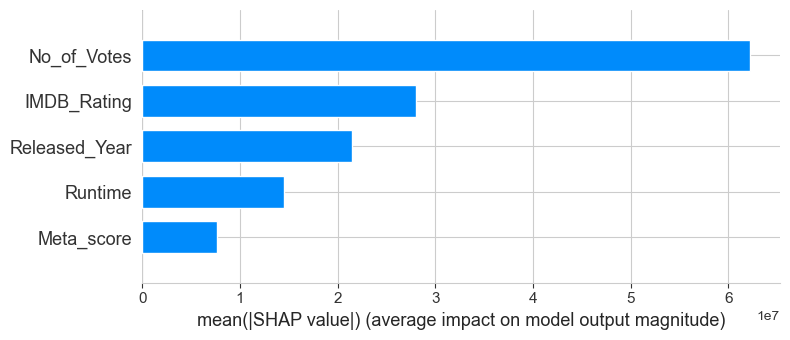

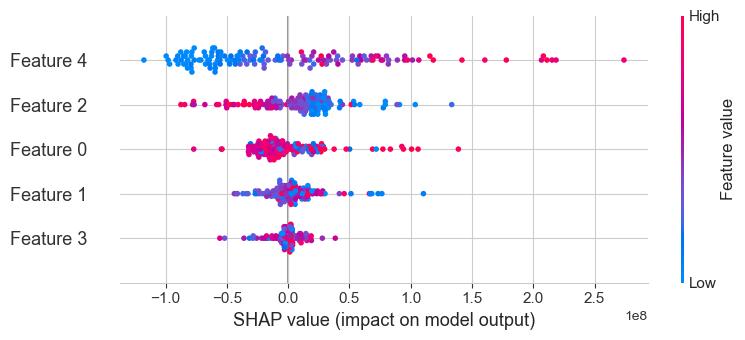

In [141]:
# Usar SHAP para explicar o modelo
explainer = shap.Explainer(pipeline.named_steps['regressor'])
X_test_transformed = pipeline.named_steps['preprocessor'].transform(X_test)
shap_values = explainer.shap_values(X_test_transformed)

# Visualizar a importância das features
shap.summary_plot(shap_values, X_test_transformed, feature_names=numeric_features, plot_type="bar")


explainer = shap.Explainer(pipeline.named_steps['regressor'])
shap_values = explainer.shap_values(X_test_transformed)
shap.summary_plot(shap_values, X_test_transformed)


In [142]:
# Avaliar a importância das variáveis
feature_importances = pipeline.named_steps['regressor'].feature_importances_

# Mostrar a importância das variáveis
importances = pd.DataFrame({'Feature': numeric_features, 'Importance': feature_importances})
importances = importances.sort_values(by='Importance', ascending=False)

print("Importância das Variáveis:")
print(importances)

Importância das Variáveis:
         Feature  Importance
4    No_of_Votes    0.523811
0  Released_Year    0.173611
2    IMDB_Rating    0.133568
1        Runtime    0.107114
3     Meta_score    0.061896


In [143]:
# Calcular e exibir as métricas de desempenho
def regression_report(y_test, y_pred):
    metrics = {
        'R2_SCORE': np.round(r2_score(y_test, y_pred), 3),
        'MAE': np.round(mean_absolute_error(y_test, y_pred), 3),
        'MAPE': np.round(mean_absolute_percentage_error(y_test, y_pred), 3),
        'MSE': np.round(mean_squared_error(y_test, y_pred), 3)
    }
    
    print('REPORT DE MÉTRICAS DE REGRESSÃO')
    print('R2_SCORE:', metrics['R2_SCORE'])
    print('MAE:', metrics['MAE'])
    print('MAPE:', metrics['MAPE'])
    print('MSE:', metrics['MSE'])

regression_report(y_test, y_pred)

REPORT DE MÉTRICAS DE REGRESSÃO
R2_SCORE: 0.109
MAE: 75617607.336
MAPE: 12.579
MSE: 1.5114176481036276e+16


In [144]:
# Visualizar a árvore de decisão
plt.figure(figsize=(20,20), dpi=1350)
plot_tree(pipeline.named_steps['regressor'], feature_names=numeric_features, filled=True, rounded=True)
plt.show()


In [145]:
# Prever o faturamento (Gross) para o filme "The Shawshank Redemption"
new_movie = pd.DataFrame({
    'Released_Year': [1994],
    'Runtime': [142],
    'IMDB_Rating': [9.3],  # Nota real do IMDB do filme
    'Meta_score': [80.0],
    'No_of_Votes': [2343110]
})

# Assegurar que os tipos de dados do novo filme correspondem aos do conjunto de treinamento
new_movie = new_movie.astype({
    'Released_Year': 'int64',
    'Runtime': 'int64',
    'IMDB_Rating': 'float64',
    'Meta_score': 'float64',
    'No_of_Votes': 'int64'
})

# Prever o faturamento
predicted_gross = pipeline.predict(new_movie)
print(f"O faturamento previsto para o filme 'The Shawshank Redemption' é: {predicted_gross[0]:.2f}")

#Salvar o modelo em formato .pkl
joblib.dump(pipeline, 'Q2_Bmodelo_pipeline_numerico.pkl')

O faturamento previsto para o filme 'The Shawshank Redemption' é: 534858444.00


['Q2_Bmodelo_pipeline_numerico.pkl']

## Dessa forma eu Consegui dizer quais as variaveis mais importantes para o meu faturamento com uma maior certeza, sendo o numero de votos e o imdb_rating as variaveis mais importantes.

## Entretanto através das metricas de avaliação, em especial o mse, é possível ver que o modelo esta longe de ser razoavel, todavia a ideia era mostrar formas de encontrar os principais variaveis responsaveis pelo alto faturamento, e isso foi um exemplo.

## Vale lembrar que não considerei as variaveis categoricas, isso é, as variaveis não numericas. 

-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

# Quero testar um modelo melhor agora, vamos agora utilizar encoders, só para poder também ver como as variaveis de categoria também influenciam no meu faturamento. Uma analise mais detalhada !!! 

In [146]:

# Carregar o dataset
path = "C:/Users/Marce/Desktop/Lighhouse/desafio_indicium_imdb.csv"
df = pd.read_csv(path)

# Remover colunas desnecessárias
df = df.loc[:, ~df.columns.str.contains('^Unnamed')]

# Limpar os dados
df = df.dropna(subset=['Certificate', 'Meta_score', 'Gross'])
df['Gross'] = df['Gross'].str.replace(',', '').astype(float)
df['Released_Year'] = pd.to_numeric(df['Released_Year'], errors='coerce').astype('Int64')
df['Runtime'] = df['Runtime'].str.replace(' min', '').astype('Int64')

# Selecionar as variáveis de interesse
features = ['Released_Year', 'Runtime', 'IMDB_Rating', 'Meta_score', 'No_of_Votes', 
            'Certificate', 'Genre', 'Director', 'Star1', 'Star2', 'Star3', 'Star4']
X = df[features]
y = df['Gross']

# Codificar variáveis categóricas usando OneHotEncoder e lidar com valores nulos usando SimpleImputer
categorical_features = ['Certificate', 'Genre', 'Director', 'Star1', 'Star2', 'Star3', 'Star4']
numeric_features = ['Released_Year', 'Runtime', 'IMDB_Rating', 'Meta_score', 'No_of_Votes']

preprocessor = ColumnTransformer(
    transformers=[
        ('num', SimpleImputer(strategy='mean'), numeric_features),
        ('cat', Pipeline(steps=[
            ('imputer', SimpleImputer(strategy='most_frequent')),
            ('onehot', OneHotEncoder(handle_unknown='ignore'))
        ]), categorical_features)
    ])

# Criar e treinar o modelo de árvore de regressão usando Pipeline
regressor = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', DecisionTreeRegressor(random_state=42))
])

# Dividir os dados em conjuntos de treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Treinar o modelo
regressor.fit(X_train, y_train)




Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', SimpleImputer(),
                                                  ['Released_Year', 'Runtime',
                                                   'IMDB_Rating', 'Meta_score',
                                                   'No_of_Votes']),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['Certificate', 'Genre',
                                                   'Director', 'Star1', 'Star2',
                                                   'Star3', 'Star4'])])),
                ('regressor', DecisionTreeRegressor(random_state=42))])

In [147]:
# Extrair os dados transformados para SHAP
X_test_transformed = regressor.named_steps['preprocessor'].transform(X_test)

# Convertendo para um DataFrame após a transformação
# O problema está no número de colunas esperado pelo DataFrame do Pandas
# Precisamos ajustar para corresponder exatamente às colunas transformadas
feature_names_out = regressor.named_steps['preprocessor'].get_feature_names_out()
X_test_transformed_df = pd.DataFrame(X_test_transformed.toarray(), columns=feature_names_out)




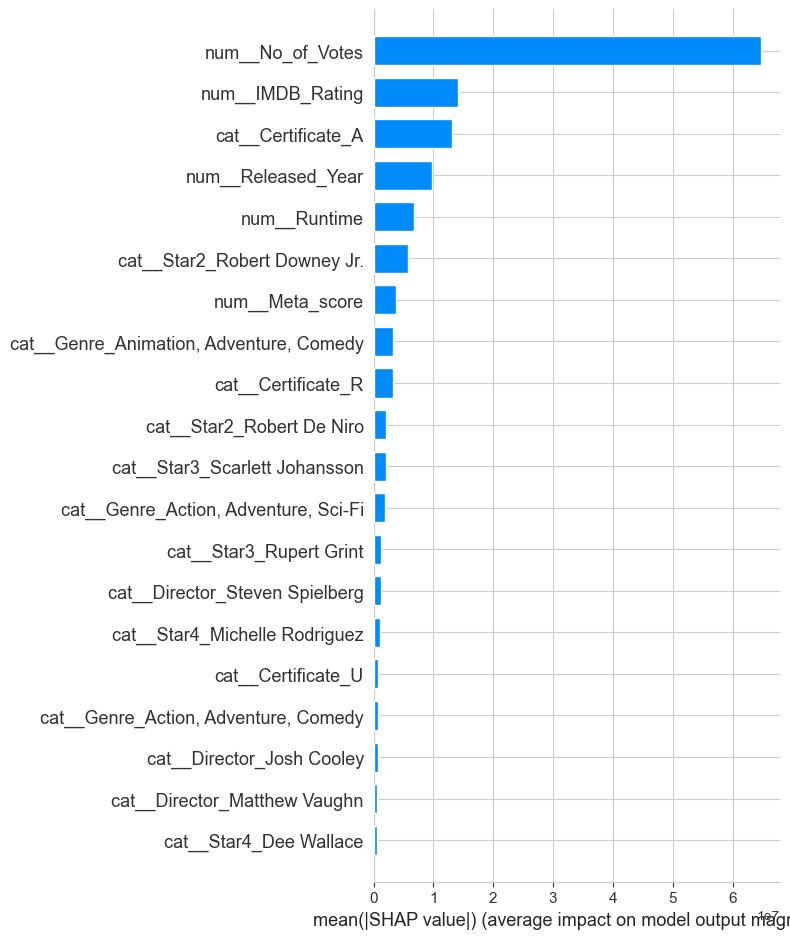

In [148]:

# Usar SHAP para explicar o modelo
explainer = shap.TreeExplainer(regressor.named_steps['regressor'])
shap_values = explainer.shap_values(X_test_transformed_df)

# Visualizar a importância das features
shap.summary_plot(shap_values, X_test_transformed_df, plot_type="bar")

# Avaliar a importância das variáveis
feature_importances = regressor.named_steps['regressor'].feature_importances_





In [149]:
def regression_report(y_test, y_pred):
    metrics = {
        'R2_SCORE': np.round(r2_score(y_test, y_pred), 3),
        'MAE': np.round(mean_absolute_error(y_test, y_pred), 3),
        'MSE': np.round(mean_squared_error(y_test, y_pred), 3)
    }
    
    print('REPORT DE MÉTRICAS DE REGRESSÃO')
    print('R2_SCORE:', metrics['R2_SCORE'])
    print('MAE:', metrics['MAE'])
    print('MSE:', metrics['MSE'])

# Realizar previsões no conjunto de teste
y_pred = regressor.predict(X_test)



In [150]:
# Avaliar e exibir as métricas de desempenho
regression_report(y_test, y_pred)

REPORT DE MÉTRICAS DE REGRESSÃO
R2_SCORE: 0.009
MAE: 62820744.049
MSE: 1.6798365754861794e+16


Importância das Variáveis:
                             Feature  Importance
4                   num__No_of_Votes    0.383817
1306    cat__Star2_Robert Downey Jr.    0.106873
2303   cat__Star4_Michelle Rodriguez    0.052853
2                   num__IMDB_Rating    0.046800
0                 num__Released_Year    0.043938
...                              ...         ...
899        cat__Star1_Toshirô Mifune    0.000000
898                 cat__Star1_Topol    0.000000
897   cat__Star1_Tony Chiu-Wai Leung    0.000000
896             cat__Star1_Tom Waits    0.000000
2474      cat__Star4_Álvaro Guerrero    0.000000

[2475 rows x 2 columns]


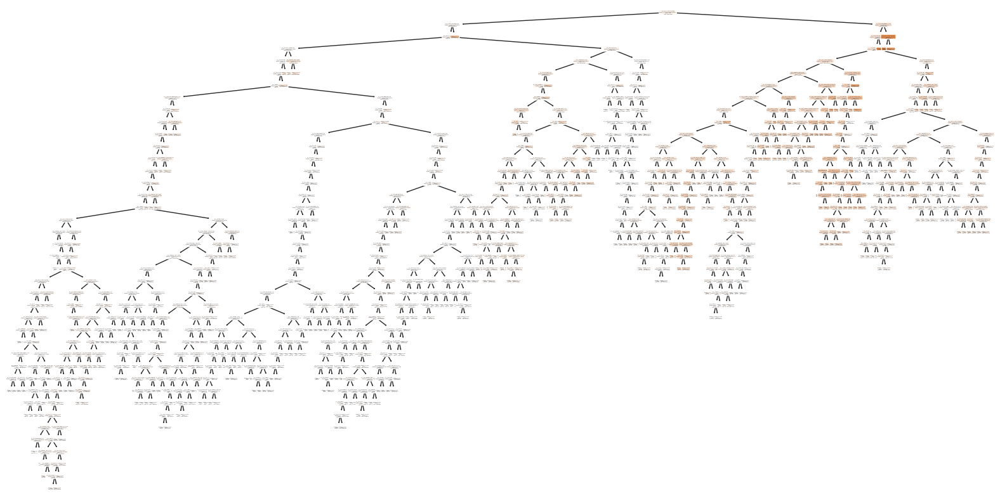

In [151]:
# Mostrar a importância das variáveis
importances = pd.DataFrame({'Feature': feature_names_out, 'Importance': feature_importances})
importances = importances.sort_values(by='Importance', ascending=False)

print("Importância das Variáveis:")
print(importances)

# Visualizar a árvore de decisão
plt.figure(figsize=(20,10))
plot_tree(regressor.named_steps['regressor'], feature_names=feature_names_out, filled=True, rounded=True)
plt.show()

In [152]:
# Prever o faturamento (Gross) para o filme "The Shawshank Redemption"
new_movie = pd.DataFrame({
    'Released_Year': [1994],
    'Runtime': [142],
    'IMDB_Rating': [9.3],  # Nota real do IMDB do filme
    'Meta_score': [80.0],
    'No_of_Votes': [2343110],
    'Certificate': ['A'],
    'Genre': ['Drama'],
    'Director': ['Frank Darabont'],
    'Star1': ['Tim Robbins'],
    'Star2': ['Morgan Freeman'],
    'Star3': ['Bob Gunton'],
    'Star4': ['William Sadler']
})

# Aplicando a transformação aos novos dados
new_movie_transformed = regressor.named_steps['preprocessor'].transform(new_movie)

# Prever o faturamento (Gross)
predicted_gross = regressor.named_steps['regressor'].predict(new_movie_transformed)
print(f"O faturamento previsto para o filme 'The Shawshank Redemption' é: {predicted_gross[0]:.2f}")


model_filename = 'Q2_Model_regressor_Com_categorias.pkl'
joblib.dump(regressor, model_filename)

print(f"Modelo salvo como {model_filename}")

O faturamento previsto para o filme 'The Shawshank Redemption' é: 107928762.00
Modelo salvo como Q2_Model_regressor_Com_categorias.pkl


## Isso mostra que adicionar ainda mais variáveis no meu modelo, sendo muitas delas insignificantes, em vez de tornar o modelo mais robusto, apenas o tornou pior!

## Basta olhar as metricas, em especial o mse para ter total certeza disso.

----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

 # C) Quais insights podem ser tirados com a coluna Overview? É possível inferir o gênero do filme a partir dessa coluna

 É sim possível obter insights em relação ao gênero do filme, também é possível tentar advinhar o nome do filme. 

 Entretanto a obtenção desses insights vão pedir um conhecimento de NLP, então mais um modelo deverá ser treinado !

Sendo sincero NLP é o modelo de machine learning que eu tenho menos familiaridade, realmente sei muito pouco sobre, sei da existencia, sei da ideia de armazenar em vetores, mas não sei muito além disso.

 

In [153]:
# Carregar o dataset
path = "C:/Users/Marce/Desktop/Lighhouse/desafio_indicium_imdb.csv"
df = pd.read_csv(path)

df = df.loc[:, ~df.columns.str.contains('^Unnamed')]

df = df.dropna(subset=['Certificate', 'Meta_score', 'Gross'])
df['Gross'] = df['Gross'].str.replace(',', '').astype(float)
df['Released_Year'] = pd.to_numeric(df['Released_Year'], errors='coerce').astype('Int64')
df['Runtime'] = df['Runtime'].str.replace(' min', '').astype('Int64')


X = df['Overview']
y = df['Genre']

# Vetorizando a coluna Overview usando TF-IDF
vectorizer = TfidfVectorizer(stop_words='english', max_features=5000)
X_tfidf = vectorizer.fit_transform(X)

# Dividindo os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X_tfidf, y, test_size=0.2, random_state=42)

# Treinando um classificador SVM
classifier = LinearSVC(random_state=42)
classifier.fit(X_train, y_train)

# Fazendo previsões e avaliando o modelo
y_pred = classifier.predict(X_test)
print(classification_report(y_test, y_pred))

# Visualizando algumas métricas adicionais
report = classification_report(y_test, y_pred, output_dict=True)
print(pd.DataFrame(report).transpose())

#Salvar o modelo treinado e o vetor TF-IDF em um arquivo pkl
model_filename = 'Q2C_Modelo_Genero_Filme_NLP.pkl'
joblib.dump((classifier, vectorizer), model_filename)
print(f"Modelo salvo como {model_filename}")

                              precision    recall  f1-score   support

           Action, Adventure       1.00      1.00      1.00         1
   Action, Adventure, Comedy       0.00      0.00      0.00         1
    Action, Adventure, Drama       0.00      0.00      0.00         2
  Action, Adventure, Fantasy       1.00      1.00      1.00         1
  Action, Adventure, History       0.00      0.00      0.00         1
   Action, Adventure, Sci-Fi       0.30      0.75      0.43         4
 Action, Adventure, Thriller       0.00      0.00      0.00         0
    Action, Biography, Drama       0.00      0.00      0.00         1
        Action, Crime, Drama       0.00      0.00      0.00         6
     Action, Crime, Thriller       0.00      0.00      0.00         3
      Action, Drama, History       0.00      0.00      0.00         0
      Action, Drama, Mystery       0.00      0.00      0.00         3
       Action, Drama, Sci-Fi       0.00      0.00      0.00         1
   Action, Mystery,

# 3) Explique como você faria a previsão da nota do imdb a partir dos dados. Quais variáveis e/ou suas transformações você utilizou e por quê? Qual tipo de problema estamos resolvendo (regressão, classificação)? Qual modelo melhor se aproxima dos dados e quais seus prós e contras? Qual medida de performance do modelo foi escolhida e por quê ?

## Respondendo por partes:
Este é claramente um problema de regressão, já que o objetivo é realizar inferências com base em dados, não uma separação de dados ou uma análise categórica.

Escolhi trabalhar com o modelo de Árvores de Decisão, mas um pipeline com vários modelos seria a melhor resposta. Modelos de árvore de decisão são de fácil visualização e relativamente simples de utilizar. No entanto, têm pontos negativos como o enviesamento que pode levar ao overfitting. Como visto anteriormente, são sensíveis, e uma nova variável pode modificar significativamente toda a árvore.

Quanto às medidas de desempenho, prefiro MSE e MAE, pois estou acostumado com elas. MSE retorna os erros acumulados, enquanto MAE retorna a média dos erros. MAPE, que indica o erro percentual absoluto médio, não é tão útil quanto as duas primeiras, mas é interessante mencionar. Já o R² é a medida de menor preferência, já que já me pediram para desconsiderá-la totalmente.

Falando sobre os pontos positivos e negativos das árvores de decisão:

Meu modelo acabou dando uma nota de 8.8, próximo de 9.3, mas não perfeito.

 # 4) Supondo umfilme com as seguintes características:
 
 {'Series_Title': 'The Shawshank Redemption',
 'Released_Year': '1994',
 'Certificate': 'A',
 'Runtime': '142 min',
 'Genre': 'Drama',
 'Overview': 'Two imprisoned men bond over a number of years,
 finding solace and eventual redemption through acts of common
 decency.',
 'Meta_score': 80.0,
 'Director': 'Frank Darabont',
 'Star1': 'Tim Robbins',
 'Star2': 'Morgan Freeman',
 'Star3': 'Bob Gunton',
 'Star4': 'William Sadler',
 'No_of_Votes': 2343110,
 'Gross': '28,341,469'}
 Qual seria a nota do IMDB?

In [154]:

# Função para carregar e preparar os dados
def load_and_prepare_data(path):
    df = pd.read_csv(path)

    # Remover colunas desnecessárias
    df = df.loc[:, ~df.columns.str.contains('^Unnamed')]

    # Limpar os dados
    df = df.dropna(subset=['Certificate', 'Meta_score', 'Gross'])
    df['Gross'] = df['Gross'].str.replace(',', '').astype(float)
    df['Released_Year'] = pd.to_numeric(df['Released_Year'], errors='coerce').astype('Int64')
    df['Runtime'] = df['Runtime'].str.replace(' min', '').astype('Int64')

    # Selecionar as variáveis de interesse
    features = ['Released_Year', 'Runtime', 'Meta_score', 'No_of_Votes', 
                'Certificate', 'Genre', 'Director', 'Star1', 'Star2', 'Star3', 'Star4', 'Gross']
    X = df[features]
    y = df['IMDB_Rating']
    return X, y



# Função para criar o pipeline completo
def create_pipeline():
    # Definir variáveis categóricas e numéricas
    categorical_features = ['Certificate', 'Genre', 'Director', 'Star1', 'Star2', 'Star3', 'Star4']
    numeric_features = ['Released_Year', 'Runtime', 'Meta_score', 'No_of_Votes', 'Gross']

    # Pipeline de pré-processamento
    preprocessor = ColumnTransformer(
        transformers=[
            ('num', SimpleImputer(strategy='mean'), numeric_features),
            ('cat', Pipeline(steps=[
                ('imputer', SimpleImputer(strategy='most_frequent')),
                ('onehot', OneHotEncoder(handle_unknown='ignore'))
            ]), categorical_features)
        ])

    # Pipeline completo incluindo preprocessor e regressor
    pipeline = Pipeline(steps=[
        ('preprocessor', preprocessor),
        ('regressor', DecisionTreeRegressor(random_state=42))
    ])
    
    return pipeline

# Caminho para o dataset
path = "C:/Users/Marce/Desktop/Lighhouse/desafio_indicium_imdb.csv"

# Carregar e preparar os dados
X, y = load_and_prepare_data(path)

# Dividir os dados em conjuntos de treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Criar o pipeline
pipeline = create_pipeline()

# Treinar o modelo
pipeline.fit(X_train, y_train)




Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', SimpleImputer(),
                                                  ['Released_Year', 'Runtime',
                                                   'Meta_score', 'No_of_Votes',
                                                   'Gross']),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['Certificate', 'Genre',
                                                   'Director', 'Star1', 'Star2',
                                                   'Star3', 'Star4'])])),
                ('regressor', DecisionTreeRegressor(random_state=42))])

In [155]:
y_pred = pipeline.predict(X_test)

In [156]:
def regression_report(y_test, y_pred):
    metrics = {
        'R2_SCORE': np.round(r2_score(y_test, y_pred), 3),
        'MAE': np.round(mean_absolute_error(y_test, y_pred), 3),
        'MAPE': np.round(mean_absolute_percentage_error(y_test, y_pred), 3),
        'MSE': np.round(mean_squared_error(y_test, y_pred), 3)
    }
    
    print('REPORT DE MÉTRICAS DE REGRESSÃO')
    print('R2_SCORE:', metrics['R2_SCORE'])
    print('MAE:', metrics['MAE'])
    print('MAPE:', metrics['MAPE'])
    print('MSE:', metrics['MSE'])

In [157]:
# Calcular e exibir as métricas de desempenho
regression_report(y_test, y_pred)

REPORT DE MÉTRICAS DE REGRESSÃO
R2_SCORE: 0.152
MAE: 0.202
MAPE: 0.025
MSE: 0.071


In [158]:
# Extrair os dados transformados para SHAP
X_test_transformed = pipeline.named_steps['preprocessor'].transform(X_test)

# Verificar o tipo e a forma dos dados transformados
print("Tipo dos dados transformados:", type(X_test_transformed))
print("Forma dos dados transformados:", X_test_transformed.shape)

# Verificar os nomes das features transformadas
feature_names = pipeline.named_steps['preprocessor'].get_feature_names_out()
print("Nomes das features transformadas:", feature_names)

# Convertendo a matriz esparsa para uma matriz densa
X_test_transformed_dense = X_test_transformed.toarray()

# Convertendo para um DataFrame após a transformação
X_test_transformed_df = pd.DataFrame(X_test_transformed_dense, columns=feature_names)

Tipo dos dados transformados: <class 'scipy.sparse._csr.csr_matrix'>
Forma dos dados transformados: (143, 2475)
Nomes das features transformadas: ['num__Released_Year' 'num__Runtime' 'num__Meta_score' ...
 'cat__Star4_Zach Grenier' 'cat__Star4_Zoe Saldana'
 'cat__Star4_Álvaro Guerrero']


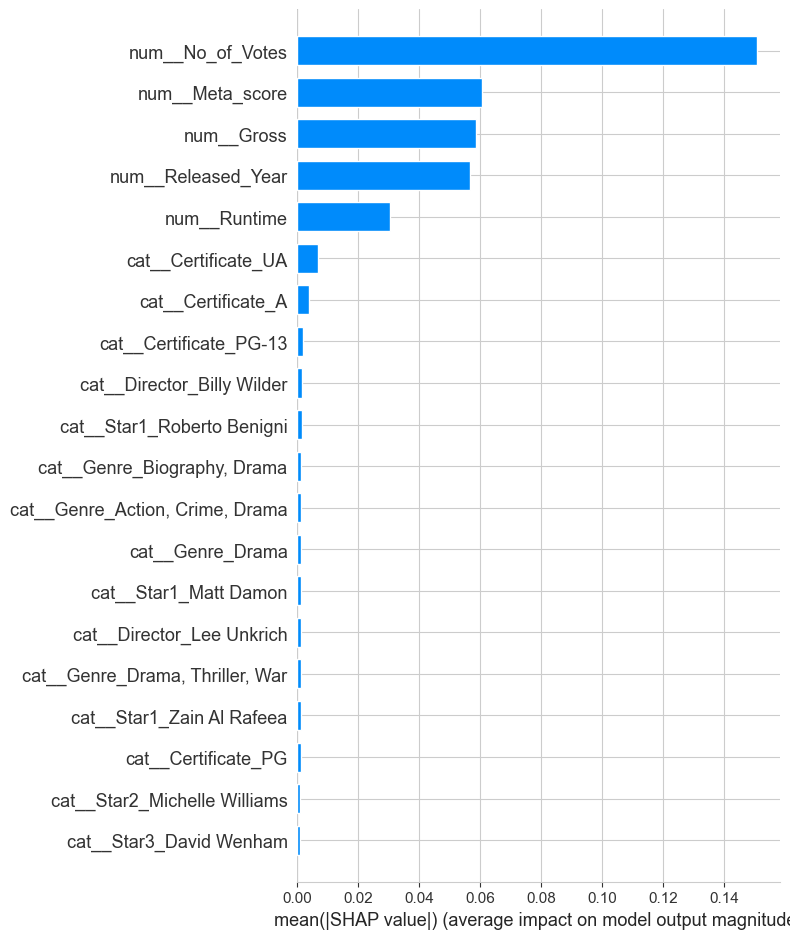

In [159]:
# Usar SHAP para explicar o modelo
explainer = shap.TreeExplainer(pipeline.named_steps['regressor'])
shap_values = explainer.shap_values(X_test_transformed_df)

# Visualizar a importância das features
shap.summary_plot(shap_values, X_test_transformed_df, plot_type="bar")

In [160]:
feature_importances = pipeline.named_steps['regressor'].feature_importances_

# Mostrar a importância das variáveis
importances = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances})
importances = importances.sort_values(by='Importance', ascending=False)

print("Importância das Variáveis:")
print(importances)

Importância das Variáveis:
                         Feature    Importance
3               num__No_of_Votes  4.945156e-01
0             num__Released_Year  1.057469e-01
2                num__Meta_score  1.043163e-01
4                     num__Gross  9.867621e-02
1                   num__Runtime  3.977489e-02
...                          ...           ...
869     cat__Star1_Seung-Yun Lee  0.000000e+00
870    cat__Star1_Shah Rukh Khan  0.000000e+00
871   cat__Star1_Shahab Hosseini  0.000000e+00
2474  cat__Star4_Álvaro Guerrero  0.000000e+00
1399    cat__Star2_Wiley Wiggins -2.998047e-16

[2475 rows x 2 columns]


In [161]:
# Prever a nota do IMDb para o filme "The Shawshank Redemption"
new_movie = pd.DataFrame({
    'Released_Year': [1994],
    'Runtime': [142],
    'Meta_score': [80.0],
    'No_of_Votes': [2343110],
    'Certificate': ['A'],
    'Genre': ['Drama'],
    'Director': ['Frank Darabont'],
    'Star1': ['Tim Robbins'],
    'Star2': ['Morgan Freeman'],
    'Star3': ['Bob Gunton'],
    'Star4': ['William Sadler'],
    'Gross': [28341469]
})

# Aplicando a transformação aos novos dados
new_movie_transformed = pipeline.named_steps['preprocessor'].transform(new_movie)
new_movie_transformed_dense = new_movie_transformed.toarray()

# Prever a nota do IMDb
predicted_rating = pipeline.named_steps['regressor'].predict(new_movie_transformed_dense)
print(f"A nota prevista do IMDb para o filme 'The Shawshank Redemption' é: {predicted_rating[0]:.2f}")



A nota prevista do IMDb para o filme 'The Shawshank Redemption' é: 8.80


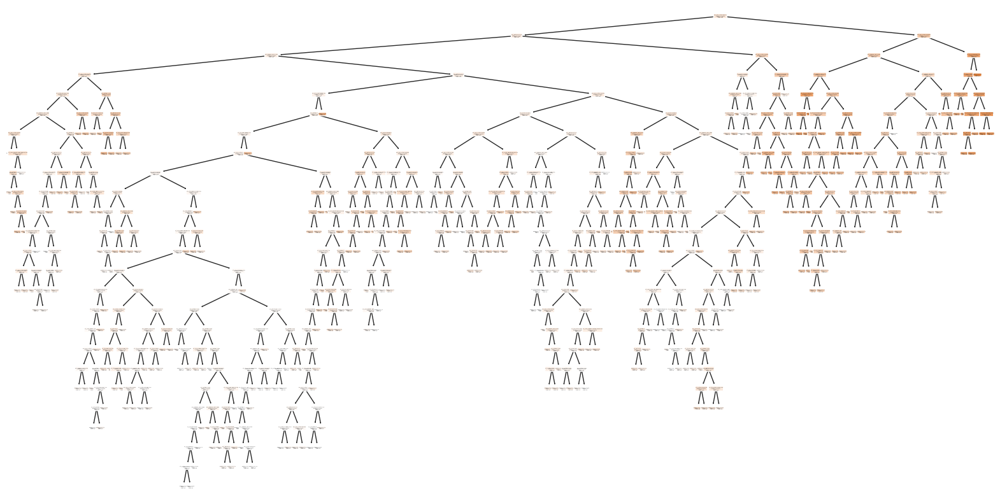

In [162]:
# Plotar a árvore de decisão
plt.figure(figsize=(20,10))
plot_tree(
    pipeline.named_steps['regressor'], 
    feature_names=feature_names, 
    filled=True, 
    rounded=True,
    #fontsize=10
)
plt.show()

In [163]:
# Salvar o modelo treinado em um arquivo pkl
model_filename = 'Q4_Model_IMDB_Rating.pkl'
joblib.dump(pipeline, model_filename)
print(f"Modelo salvo como {model_filename}")

Modelo salvo como Q4_Model_IMDB_Rating.pkl


# Olhando através das metricas, esse é sim um modelo razoavelmente bom. Um MSE agradavel, e um MAE de 0.202 sugere que, em média, as predições do modelo estão a 0.202 unidades da variável alvo real.

# Brincando com um modelo SVM Para prever faturamentos Como na segunda questão !!! 

# Isso é só um bonus teste


In [164]:
def pipe_pre_process_desafio():
    # Para facilitação de carregamento e transformação de dados
    
    # Para facilitação de carregamento e transformação de dados
    path = "C:/Users/Marce/Desktop/Lighhouse/desafio_indicium_imdb.csv"
    df = pd.read_csv(path)
    df = df.loc[:, ~df.columns.str.contains('^Unnamed')]

    # Remover linhas com valores nulos nas colunas principais
    df = df.dropna(subset=['Certificate', 'Meta_score', 'Gross'])

    # Converter e limpar dados
    df['Gross'] = df['Gross'].str.replace(',', '').astype(float)
    df['Released_Year'] = pd.to_numeric(df['Released_Year'], errors='coerce').astype('Int64')
    df['Runtime'] = df['Runtime'].str.replace(' min', '').astype('Int64')


    # Definição de features e target
    X = df.drop(columns='Gross')
    y = df["Gross"]
 
    
    '''
    se remover valores unicos for um problema
    
    y_value_counts = df['Gross'].value_counts()
    unique_values = y_value_counts[y_value_counts == 1].index
    df = df[~df['Gross'].isin(unique_values)]

    '''


    # Particionamento dos conjuntos de treino e teste
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)
    
    #================================
    # Tratamento dos dados numéricos
    pipe_features_num = Pipeline([("input_num", SimpleImputer(strategy = "mean")), # substituindo valores nulos pela média
                                 ("scaler", StandardScaler())]) # padronização dos dados
    
    
    features_num = X_train.select_dtypes(include=np.number).columns.tolist() # selecionando apenas as colunas numéricas
    #==============================
    # Tratamento de features categóricas
    pipe_features_cat = Pipeline([("input_cat", SimpleImputer(strategy = "constant", fill_value = "unknown")), # dados categóricos faltantes
                                 ("onehot", OneHotEncoder())]) # transformação de dados categóricos
    
    features_cat = X_train.select_dtypes(exclude=np.number).columns.tolist() # selecionando apenas colunas categóricas
    #==============================
    # Aplicando as transformações nos nossos dados
    pre_processador = ColumnTransformer([("transf_num", pipe_features_num, features_num),
                                        ("transf_cat", pipe_features_cat, features_cat)])
    
    return X_train, X_test, y_train, y_test, pre_processador

In [165]:


# Pré-processamento
X_train, X_test, y_train, y_test, pre_processador = pipe_pre_process_desafio()

features = ['No_of_Votes']

svr = SVR(epsilon = 10)
svr.fit(X_train[features], y_train)

SVR(epsilon=10)

In [166]:
from sklearn.linear_model import LinearRegression

X_train, X_test, y_train, y_test, pre_processador = pipe_pre_process_desafio()

LR = LinearRegression()
LR.fit(X_train[features], y_train)

LinearRegression()

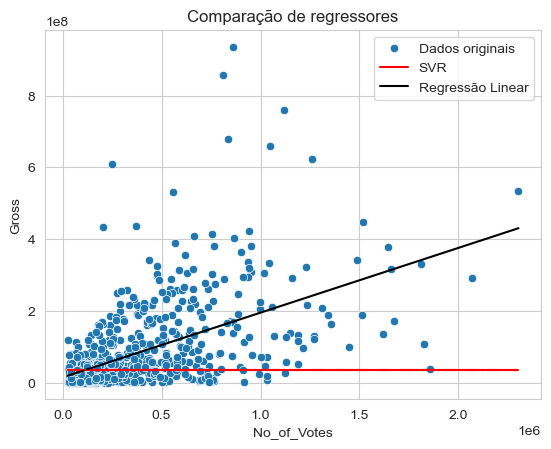

In [167]:
sns.scatterplot(data = df,
                x = 'No_of_Votes',
                y = 'Gross')

# Vamos gerar valores para "x" e realizar as predições correspondentes
x_range = np.linspace(X_train[features].min(), X_train[features].max(), 100)

y_LR = LR.predict(x_range.reshape(-1,1))
y_svr = svr.predict(x_range.reshape(-1,1))

plt.plot(x_range, y_svr, 'r') # plota o regressor SVR
plt.plot(x_range, y_LR, 'k') #plota o regressor linear

plt.legend(["Dados originais", "SVR", "Regressão Linear"])
plt.title("Comparação de regressores")

plt.plot(x_range, y_svr + 10, '-.r', alpha = 0.6)
plt.plot(x_range, y_svr - 10, '-.r', alpha = 0.6)

In [168]:
# Similarmente ao que fizemos acima, mas para regressão:
def metricas_regressao(estimator, features):
    #=================
    print("\nMétricas da avaliação de treino:")
    y_pred_train = estimator.predict(X_train[features]) # predição sobre os dados de treinamento
    
    print(f"R^2: {r2_score(y_train, y_pred_train):.2f}")
    print(f"MAE: {mean_absolute_error(y_train, y_pred_train):.2f}")
    print(f"RMSE: {np.sqrt(mean_squared_error(y_train, y_pred_train)):.2f}")
    
    #=================
    print("\nMétricas da avaliação de teste:")
    y_pred_test = estimator.predict(X_test[features]) # predição sobre os dados de teste
    
    print(f"R^2: {r2_score(y_test, y_pred_test):.2f}")
    print(f"MAE: {mean_absolute_error(y_test, y_pred_test):.2f}")
    print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_pred_test)):.2f}")

In [169]:
metricas_regressao(svr, features)


Métricas da avaliação de treino:
R^2: -0.15
MAE: 66999711.50
RMSE: 118974492.84

Métricas da avaliação de teste:
R^2: -0.14
MAE: 73137453.59
RMSE: 138911377.24


In [170]:
metricas_regressao(LR, features)


Métricas da avaliação de treino:
R^2: 0.33
MAE: 57887822.74
RMSE: 90995515.90

Métricas da avaliação de teste:
R^2: 0.28
MAE: 60869386.65
RMSE: 110351956.85


# Com novos parametros !!

In [171]:
svr = SVR(C = 1000, epsilon = 10)
svr.fit(X_train[features], y_train)

SVR(C=1000, epsilon=10)

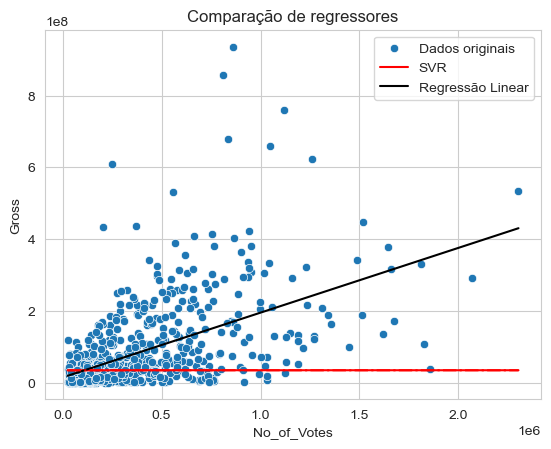

In [172]:
sns.scatterplot(data = df,
                x = 'No_of_Votes',
                y = 'Gross')

# Vamos gerar valores para "x" e realizar as predições correspondentes
x_range = np.linspace(X_train[features].min(), X_train[features].max(), 100)

y_LR = LR.predict(x_range.reshape(-1,1))
y_svr = svr.predict(x_range.reshape(-1,1))

plt.plot(x_range, y_svr, 'r') # plota o regressor SVR
plt.plot(x_range, y_LR, 'k') #plota o regressor linear

plt.legend(["Dados originais", "SVR", "Regressão Linear"])
plt.title("Comparação de regressores")

plt.plot(x_range, y_svr + 10, '-.r', alpha = 0.6)
plt.plot(x_range, y_svr - 10, '-.r', alpha = 0.6)

In [173]:
metricas_regressao(svr, features)


Métricas da avaliação de treino:
R^2: -0.15
MAE: 66962771.20
RMSE: 118919744.09

Métricas da avaliação de teste:
R^2: -0.14
MAE: 73094739.51
RMSE: 138860612.19


-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

In [174]:
!pip freeze > requirements.txt

In [175]:

with open("requirements.txt", "r") as f:
    lines = f.readlines()

# Criação da estrutura básica do environment.yml
env = {
    "name": "lighthouse_env",  # Nome do ambiente Conda
    "channels": ["defaults"],
    "dependencies": [
        "python=3.9.19",  
        {
            "pip": [line.strip() for line in lines if line.strip()]
        }
    ]
}

# Salvando em environment.yml
with open("environment.yml", "w") as f:
    yaml.dump(env, f, default_flow_style=False)

